## Import Libraries

In [2]:
import warnings
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import lightgbm as lgbm
import plotly.tools as tls
import plotly.offline as py
import plotly.graph_objs as go
from scipy.stats import randint as sp_randint
from scipy.stats import uniform as sp_uniform
from sklearn.preprocessing import FunctionTransformer
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import RandomizedSearchCV, cross_val_score, train_test_split
from sklearn.metrics import roc_auc_score, confusion_matrix, roc_curve,\
                            precision_recall_curve, classification_report, accuracy_score

%matplotlib inline
pd.set_option('display.max_columns', None)
warnings.filterwarnings('ignore')

## Read the data

In [2]:
df = pd.read_csv('../data/creditcard.csv')
df.head()

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,0.090794,-0.551600,-0.617801,-0.991390,-0.311169,1.468177,-0.470401,0.207971,0.025791,0.403993,0.251412,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,-0.166974,1.612727,1.065235,0.489095,-0.143772,0.635558,0.463917,-0.114805,-0.183361,-0.145783,-0.069083,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
2,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,0.207643,0.624501,0.066084,0.717293,-0.165946,2.345865,-2.890083,1.109969,-0.121359,-2.261857,0.524980,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0
3,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,-0.054952,-0.226487,0.178228,0.507757,-0.287924,-0.631418,-1.059647,-0.684093,1.965775,-1.232622,-0.208038,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
4,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,0.753074,-0.822843,0.538196,1.345852,-1.119670,0.175121,-0.451449,-0.237033,-0.038195,0.803487,0.408542,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0


## Approach-1 : Normalizing 'Amount' column and eliminating 'time' column

### 1.Feature Engineering

##### Normalization of 'Amount' column

In [3]:
df['Amount'] = StandardScaler().fit_transform(df['Amount'].values.reshape(-1,1))

In [4]:
# Drop useless variables
df = df.drop(['Time'],axis=1)  

##### Prepare features and labels

In [5]:
# def x and y
y = np.array(df.Class.tolist())
x = np.array(df.drop('Class',axis=1))

##### Train Test Split

In [6]:
# Train_test split
random_state = 7
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.20, random_state = random_state, stratify = y)

### 2.Model Building

#### Model-1 : Light gbm

In [7]:
def lgbm_model(x_train, y_train, x_test, y_test):
  clf = lgbm.LGBMClassifier(n_estimators=100, random_state = 42, verbose=-100)
  clf.fit(x_train, y_train)
  y_train_pred=clf.predict(x_train)
  y_train_cl_report=classification_report(y_train, y_train_pred, target_names = ['No Fraud', 'Fraud'])
  print("_"*100)
  print("TRAIN MODEL CLASSIFICATION REPORT")
  print("_"*100)
  print(y_train_cl_report)
  y_pred=clf.predict(x_test)
  y_score = clf.predict_proba(x_test)[:,1]
  y_test_cl_report=classification_report(y_test, y_pred, target_names = ['No Fraud', 'Fraud'])
  print("_"*100)
  print("TEST MODEL CLASSIFICATION REPORT")
  print("_"*100)
  print(y_test_cl_report)
  print("_"*100)
  return y_pred, y_score, clf


In [8]:
y_pred, y_score, lgbm_clf= lgbm_model(x_train, y_train, x_test, y_test)

____________________________________________________________________________________________________
TRAIN MODEL CLASSIFICATION REPORT
____________________________________________________________________________________________________
              precision    recall  f1-score   support

    No Fraud       1.00      1.00      1.00    227451
       Fraud       0.41      0.73      0.52       394

    accuracy                           1.00    227845
   macro avg       0.70      0.86      0.76    227845
weighted avg       1.00      1.00      1.00    227845

____________________________________________________________________________________________________
TEST MODEL CLASSIFICATION REPORT
____________________________________________________________________________________________________
              precision    recall  f1-score   support

    No Fraud       1.00      1.00      1.00     56864
       Fraud       0.32      0.66      0.43        98

    accuracy                          

#### Model Performance

In [9]:
def model_performance_lgbm(model,**kwargs) : 
    #Conf matrix
    conf_matrix = confusion_matrix(kwargs['y_test'], kwargs['y_pred'])
    trace1 = go.Heatmap(z = conf_matrix  ,x = ["0 (No Fraud) pred","1 (Fraud) pred"],
                        y = ["0 (No Fraud) actual","1 (Fraud) actual"],xgap = 2, ygap = 2, 
                        colorscale = 'earth', showscale  = False)

    annotations = []
    for i in range(len(conf_matrix)):
       for j in range(len(conf_matrix)):
              annotations.append(
                     dict(
                     x=j,
                     y=i,
                     text=str(conf_matrix[i][j]),
                     font=dict(color='white'),
                     showarrow=False
              )
              )
    
    #Show metrics
    tp = conf_matrix[1,1]
    fn = conf_matrix[1,0]
    fp = conf_matrix[0,1]
    tn = conf_matrix[0,0]
    Accuracy  =  ((tp+tn)/(tp+tn+fp+fn))
    Precision =  (tp/(tp+fp))
    Recall    =  (tp/(tp+fn))
    F1_score  =  (2*(((tp/(tp+fp))*(tp/(tp+fn)))/((tp/(tp+fp))+(tp/(tp+fn)))))

    show_metrics = pd.DataFrame(data=[[Accuracy , Precision, Recall, F1_score]])
    show_metrics = show_metrics.T

    colors = ['gold', 'lightgreen', 'lightcoral', 'lightskyblue']
    trace2 = go.Bar(x = (show_metrics[0].values), 
                   y = ['Accuracy', 'Precision', 'Recall', 'F1_score'], text = np.round_(show_metrics[0].values,4),
                    textposition = 'auto',
                   orientation = 'h', opacity = 0.8,marker=dict(
            color=colors,
            line=dict(color='#000000',width=1.5)))
    
    #Roc curve
    model_roc_auc = round(roc_auc_score(kwargs['y_test'], kwargs['y_score']) , 3)
    fpr, tpr, t = roc_curve(kwargs['y_test'], kwargs['y_score'])
    trace3 = go.Scatter(x = fpr,y = tpr,
                        name = "Roc : " + str(model_roc_auc),
                        line = dict(color = ('rgb(22, 96, 167)'),width = 2), fill='tozeroy')
    trace4 = go.Scatter(x = [0,1],y = [0,1],
                        line = dict(color = ('black'),width = 1.5,
                        dash = 'dot'))
    
    # Precision-recall curve
    precision, recall, thresholds = precision_recall_curve(kwargs['y_test'], kwargs['y_score'])
    trace5 = go.Scatter(x = recall, y = precision,
                        name = "Precision" + str(precision),
                        line = dict(color = ('lightcoral'),width = 2), fill='tozeroy')
    
    #Feature importance
    try:
       try: coefficients  = pd.DataFrame(eval(model).feature_importances_)
       except: coefficients  = pd.DataFrame(model.feature_importances_)
       column_data   = pd.DataFrame(list(df))
       coef_sumry    = (pd.merge(coefficients,column_data,left_index= True,
                                   right_index= True, how = "left"))
       coef_sumry.columns = ["coefficients","features"]
       coef_sumry    = coef_sumry.sort_values(by = "coefficients",ascending = False)
       coef_sumry = coef_sumry[coef_sumry["coefficients"] !=0]
       trace6 = go.Bar(x = coef_sumry["features"],y = coef_sumry["coefficients"],
                     name = "coefficients",
                     marker = dict(color = coef_sumry["coefficients"],
                                   colorscale = "Viridis",
                                   line = dict(width = .6,color = "black")))
    except: pass

    #Cumulative gain
    pos = pd.get_dummies(kwargs['y_test']).values
    pos = pos[:,1] 
    npos = np.sum(pos)
    index = np.argsort(kwargs['y_score']) 
    index = index[::-1] 
    sort_pos = pos[index]
    #cumulative sum
    cpos = np.cumsum(sort_pos) 
    #recall
    recall = cpos/npos 
    #size obs test
    n = y_test.shape[0] 
    size = np.arange(start=1,stop=369,step=1) 
    #proportion
    size = size / n 
    #plots
    model = model
    trace7 = go.Scatter(x = size,y = recall,
                        name = "Lift curve",
                        line = dict(color = ('gold'),width = 2), fill='tozeroy') 
    
    #Subplots
    fig = tls.make_subplots(rows=4, cols=2, print_grid=False, 
                          specs=[[{}, {}], 
                                 [{}, {}],
                                 [{'colspan': 2}, None],
                                 [{'colspan': 2}, None]],
                          subplot_titles=('Confusion Matrix',
                                        'Metrics',
                                        'ROC curve'+" "+ '('+ str(model_roc_auc)+')',
                                        'Precision - Recall curve',
                                        'Cumulative gains curve',
                                        'Feature importance',
                                        ))
    
    fig.append_trace(trace1,1,1)
    fig.append_trace(trace2,1,2)
    fig.append_trace(trace3,2,1)
    fig.append_trace(trace4,2,1)
    fig.append_trace(trace5,2,2)
    try: fig.append_trace(trace6,4,1)
    except: pass
    fig.append_trace(trace7,3,1)

    for i in range(len(conf_matrix)):
       for j in range(len(conf_matrix[0])):
              fig.add_annotation(
              x=j,
              y=i,
              text=str(conf_matrix[i][j]),
              showarrow=False,
              font=dict(color='white', size=12),  # Adjust font size if needed
              xref='x1',
              yref='y1'
              )
    
    fig['layout'].update(showlegend = False, title = '<b>Model performance report</b><br>'+str(model),
                        autosize = False, height = 1500,width = 830,
                        plot_bgcolor = 'rgba(240,240,240, 0.95)',
                        paper_bgcolor = 'rgba(240,240,240, 0.95)',
                        margin = dict(b = 195))
    fig["layout"]["xaxis2"].update((dict(range=[0, 1])))
    fig["layout"]["xaxis3"].update(dict(title = "false positive rate"))
    fig["layout"]["yaxis3"].update(dict(title = "true positive rate"))
    fig["layout"]["xaxis4"].update(dict(title = "recall"), range = [0,1.05])
    fig["layout"]["yaxis4"].update(dict(title = "precision"), range = [0,1.05])
    fig["layout"]["xaxis5"].update(dict(title = "Percentage contacted"))
    fig["layout"]["yaxis5"].update(dict(title = "Percentage positive targeted"))
    fig.layout.titlefont.size = 14
    
    py.iplot(fig)

In [10]:
data = {'x_train':x_train,'x_test':x_test,'y_train':y_train,'y_test':y_test,'y_pred':y_pred,'y_score':y_score}
model_performance_lgbm('lgbm_clf', **data)

#### Hyperparameter Tuning

In [50]:
fit_params = {#"early_stopping_rounds" : 50, 
             "eval_metric" : 'binary', 
             "eval_set" : [(x_test,y_test)],
             'eval_names': ['valid'],
             #'verbose': 0,
             'categorical_feature': 'auto'}

param_test = {'learning_rate' : [0.01, 0.02, 0.03, 0.04, 0.05, 0.08, 0.1, 0.2, 0.3, 0.4],
              'n_estimators' : [100, 200, 300, 400, 500, 600, 800, 1000, 1500, 2000, 3000, 5000],
              'num_leaves': sp_randint(6, 50), 
              'min_child_samples': sp_randint(100, 500), 
              'min_child_weight': [1e-5, 1e-3, 1e-2, 1e-1, 1, 1e1, 1e2, 1e3, 1e4],
              'subsample': sp_uniform(loc=0.2, scale=0.8), 
              'max_depth': [-1, 1, 2, 3, 4, 5, 6, 7],
              'colsample_bytree': sp_uniform(loc=0.4, scale=0.6),
              'reg_alpha': [0, 1e-1, 1, 2, 5, 7, 10, 50, 100],
              'reg_lambda': [0, 1e-1, 1, 5, 10, 20, 50, 100]}

#number of combinations
n_iter = 200

#intialize lgbm and lunch the search
lgbm_clf = lgbm.LGBMClassifier(random_state=random_state, silent=True, metric='None', n_jobs=4, verbose=-100)
grid_search = RandomizedSearchCV(
    estimator=lgbm_clf, param_distributions=param_test, 
    n_iter=n_iter,
    scoring='accuracy',
    cv=5,
    refit=True,
    random_state=random_state,
    verbose=True)

grid_search.fit(x_train, y_train, **fit_params)
print('Best score reached: {} with params: {} '.format(grid_search.best_score_, grid_search.best_params_))

opt_parameters =  grid_search.best_params_

clf_sw = lgbm.LGBMClassifier(**lgbm_clf.get_params())
#Optimal parameter
clf_sw.set_params(**opt_parameters)

Fitting 5 folds for each of 200 candidates, totalling 1000 fits
Best score reached: 0.9995698830345191 with params: {'colsample_bytree': 0.7260693525481623, 'learning_rate': 0.3, 'max_depth': 5, 'min_child_samples': 205, 'min_child_weight': 1e-05, 'n_estimators': 500, 'num_leaves': 26, 'reg_alpha': 0, 'reg_lambda': 10, 'subsample': 0.836186646848917} 


LGBMClassifier(colsample_bytree=0.7260693525481623, learning_rate=0.3,
               max_depth=5, metric='None', min_child_samples=205,
               min_child_weight=1e-05, n_estimators=500, n_jobs=4,
               num_leaves=26, random_state=7, reg_alpha=0, reg_lambda=10,
               silent=True, subsample=0.836186646848917, verbose=-100)

#### LightGBM Model Training After Hyperparameter Tuning(RandomizedSearchCV)

In [11]:
def lgbm_model_tuned(x_train, y_train, x_test, y_test):
  clf = lgbm.LGBMClassifier(colsample_bytree=0.7260693525481623,
        learning_rate=0.3, max_depth=5, metric='None',
        min_child_samples=205, min_child_weight=0.00001,
        n_estimators=500, n_jobs=4, num_leaves=26,
        random_state=7, reg_alpha=0, reg_lambda=10, silent=True,
        subsample=0.836186646848917, verbose=-100)
  
  clf.fit(x_train, y_train)
  y_train_pred=clf.predict(x_train)
  y_train_cl_report=classification_report(y_train, y_train_pred, target_names = ['No Fraud', 'Fraud'])
  print("_"*100)
  print("TRAIN MODEL CLASSIFICATION REPORT")
  print("_"*100)
  print(y_train_cl_report)
  y_pred=clf.predict(x_test)
  y_score = clf.predict_proba(x_test)[:,1]
  y_test_cl_report=classification_report(y_test, y_pred, target_names = ['No Fraud', 'Fraud'])
  print("_"*100)
  print("TEST MODEL CLASSIFICATION REPORT")
  print("_"*100)
  print(y_test_cl_report)
  print("_"*100)
  return y_pred, y_score, clf


In [12]:
y_pred, y_score, lgbm_clf_tuned= lgbm_model_tuned(x_train, y_train, x_test, y_test)

____________________________________________________________________________________________________
TRAIN MODEL CLASSIFICATION REPORT
____________________________________________________________________________________________________
              precision    recall  f1-score   support

    No Fraud       1.00      1.00      1.00    227451
       Fraud       1.00      1.00      1.00       394

    accuracy                           1.00    227845
   macro avg       1.00      1.00      1.00    227845
weighted avg       1.00      1.00      1.00    227845

____________________________________________________________________________________________________
TEST MODEL CLASSIFICATION REPORT
____________________________________________________________________________________________________
              precision    recall  f1-score   support

    No Fraud       1.00      1.00      1.00     56864
       Fraud       0.98      0.81      0.88        98

    accuracy                          

##### Model Performance

In [13]:
data = {'x_train':x_train,'x_test':x_test,'y_train':y_train,'y_test':y_test,'y_pred':y_pred,'y_score':y_score}
model_performance_lgbm('lgbm_clf_tuned',**data)

### Model-2 : Logistic Regression

In [14]:
def logic_regression(x_train, y_train, x_test, y_test):
  clf=LogisticRegression()
  clf.fit(x_train, y_train)
  y_train_pred=clf.predict(x_train)
  y_train_cl_report=classification_report(y_train, y_train_pred, target_names = ['No Fraud', 'Fraud'])
  print("_"*100)
  print("TRAIN MODEL CLASSIFICATION REPORT")
  print("_"*100)
  print(y_train_cl_report)
  y_pred=clf.predict(x_test)
  y_score = clf.predict_proba(x_test)[:,1]
  y_test_cl_report=classification_report(y_test, y_pred, target_names = ['No Fraud', 'Fraud'])
  print("_"*100)
  print("TEST MODEL CLASSIFICATION REPORT")
  print("_"*100)
  print(y_test_cl_report)
  print("_"*100)
  return y_pred, y_score, clf


In [15]:
y_pred, y_score, lr= logic_regression(x_train, y_train, x_test, y_test)

____________________________________________________________________________________________________
TRAIN MODEL CLASSIFICATION REPORT
____________________________________________________________________________________________________
              precision    recall  f1-score   support

    No Fraud       1.00      1.00      1.00    227451
       Fraud       0.87      0.62      0.72       394

    accuracy                           1.00    227845
   macro avg       0.94      0.81      0.86    227845
weighted avg       1.00      1.00      1.00    227845

____________________________________________________________________________________________________
TEST MODEL CLASSIFICATION REPORT
____________________________________________________________________________________________________
              precision    recall  f1-score   support

    No Fraud       1.00      1.00      1.00     56864
       Fraud       0.92      0.61      0.74        98

    accuracy                          

##### Model Performance

In [16]:
def model_performance(model,**kwargs) : 
    #Conf matrix
    conf_matrix = confusion_matrix(kwargs['y_test'], kwargs['y_pred'])
    trace1 = go.Heatmap(z = conf_matrix  ,x = ["0 (No Fraud) pred","1 (Fraud) pred"],
                        y = ["0 (No Fraud) actual","1 (Fraud) actual"],xgap = 2, ygap = 2, 
                        colorscale = 'earth', showscale  = False)

    annotations = []
    for i in range(len(conf_matrix)):
       for j in range(len(conf_matrix)):
              annotations.append(
                     dict(
                     x=j,
                     y=i,
                     text=str(conf_matrix[i][j]),
                     font=dict(color='white'),
                     showarrow=False
              )
              )
    
    #Show metrics
    tp = conf_matrix[1,1]
    fn = conf_matrix[1,0]
    fp = conf_matrix[0,1]
    tn = conf_matrix[0,0]
    Accuracy  =  ((tp+tn)/(tp+tn+fp+fn))
    Precision =  (tp/(tp+fp))
    Recall    =  (tp/(tp+fn))
    F1_score  =  (2*(((tp/(tp+fp))*(tp/(tp+fn)))/((tp/(tp+fp))+(tp/(tp+fn)))))

    show_metrics = pd.DataFrame(data=[[Accuracy , Precision, Recall, F1_score]])
    show_metrics = show_metrics.T

    colors = ['gold', 'lightgreen', 'lightcoral', 'lightskyblue']
    trace2 = go.Bar(x = (show_metrics[0].values), 
                   y = ['Accuracy', 'Precision', 'Recall', 'F1_score'], text = np.round_(show_metrics[0].values,4),
                    textposition = 'auto',
                   orientation = 'h', opacity = 0.8,marker=dict(
            color=colors,
            line=dict(color='#000000',width=1.5)))
    
    #Roc curve
    model_roc_auc = round(roc_auc_score(kwargs['y_test'], kwargs['y_score']) , 3)
    fpr, tpr, t = roc_curve(kwargs['y_test'], kwargs['y_score'])
    trace3 = go.Scatter(x = fpr,y = tpr,
                        name = "Roc : " + str(model_roc_auc),
                        line = dict(color = ('rgb(22, 96, 167)'),width = 2), fill='tozeroy')
    trace4 = go.Scatter(x = [0,1],y = [0,1],
                        line = dict(color = ('black'),width = 1.5,
                        dash = 'dot'))
    
    # Precision-recall curve
    precision, recall, thresholds = precision_recall_curve(kwargs['y_test'], kwargs['y_score'])
    trace5 = go.Scatter(x = recall, y = precision,
                        name = "Precision" + str(precision),
                        line = dict(color = ('lightcoral'),width = 2), fill='tozeroy')

    #Cumulative gain
    pos = pd.get_dummies(kwargs['y_test']).values
    pos = pos[:,1] 
    npos = np.sum(pos)
    index = np.argsort(kwargs['y_score']) 
    index = index[::-1] 
    sort_pos = pos[index]
    #cumulative sum
    cpos = np.cumsum(sort_pos) 
    #recall
    recall = cpos/npos 
    #size obs test
    n = y_test.shape[0] 
    size = np.arange(start=1,stop=369,step=1) 
    #proportion
    size = size / n 
    #plots
    model = model
    trace7 = go.Scatter(x = size,y = recall,
                        name = "Lift curve",
                        line = dict(color = ('gold'),width = 2), fill='tozeroy') 
    
    #Subplots
    fig = tls.make_subplots(rows=3, cols=2, print_grid=False, 
                          specs=[[{}, {}], 
                                 [{}, {}],
                                 [{'colspan': 2}, None]],
                          subplot_titles=('Confusion Matrix',
                                        'Metrics',
                                        'ROC curve'+" "+ '('+ str(model_roc_auc)+')',
                                        'Precision - Recall curve',
                                        'Cumulative gains curve',
                                        ))
    
    fig.append_trace(trace1,1,1)
    fig.append_trace(trace2,1,2)
    fig.append_trace(trace3,2,1)
    fig.append_trace(trace4,2,1)
    fig.append_trace(trace5,2,2)
    fig.append_trace(trace7,3,1)

    for i in range(len(conf_matrix)):
       for j in range(len(conf_matrix[0])):
              fig.add_annotation(
              x=j,
              y=i,
              text=str(conf_matrix[i][j]),
              showarrow=False,
              font=dict(color='white', size=12),  # Adjust font size if needed
              xref='x1',
              yref='y1'
              )
    
    fig['layout'].update(showlegend = False, title = '<b>Model performance report</b><br>'+str(model),
                        autosize = False, height = 1500,width = 830,
                        plot_bgcolor = 'rgba(240,240,240, 0.95)',
                        paper_bgcolor = 'rgba(240,240,240, 0.95)',
                        margin = dict(b = 195))
    fig["layout"]["xaxis2"].update((dict(range=[0, 1])))
    fig["layout"]["xaxis3"].update(dict(title = "false positive rate"))
    fig["layout"]["yaxis3"].update(dict(title = "true positive rate"))
    fig["layout"]["xaxis4"].update(dict(title = "recall"), range = [0,1.05])
    fig["layout"]["yaxis4"].update(dict(title = "precision"), range = [0,1.05])
    fig["layout"]["xaxis5"].update(dict(title = "Percentage contacted"))
    fig["layout"]["yaxis5"].update(dict(title = "Percentage positive targeted"))
    fig.layout.titlefont.size = 14
    
    py.iplot(fig)

In [17]:
data = {'x_train':x_train,'x_test':x_test,'y_train':y_train,'y_test':y_test,'y_pred':y_pred,'y_score':y_score}
model_performance('lr',**data)

### Model-3 : KNEIGHBORS CLASSIFICATION MODEL

In [18]:
def KNeighbors(x_train, y_train, x_test, y_test):
  clf=KNeighborsClassifier(n_neighbors=4)
  clf.fit(x_train, y_train)
  y_train_pred=clf.predict(x_train)
  y_train_cl_report=classification_report(y_train, y_train_pred, target_names = ['No Fraud', 'Fraud'])
  print("_"*100)
  print("TRAIN MODEL CLASSIFICATION REPORT")
  print("_"*100)
  print(y_train_cl_report)
  y_pred=clf.predict(x_test)
  y_score = clf.predict_proba(x_test)[:,1]
  y_test_cl_report=classification_report(y_test, y_pred, target_names = ['No Fraud', 'Fraud'])
  print("_"*100)
  print("TEST MODEL CLASSIFICATION REPORT")
  print("_"*100)
  print(y_test_cl_report)
  print("_"*100)
  return y_pred, y_score, clf


In [19]:
y_pred, y_score, knn= KNeighbors(x_train, y_train, x_test, y_test)

____________________________________________________________________________________________________
TRAIN MODEL CLASSIFICATION REPORT
____________________________________________________________________________________________________
              precision    recall  f1-score   support

    No Fraud       1.00      1.00      1.00    227451
       Fraud       0.98      0.79      0.87       394

    accuracy                           1.00    227845
   macro avg       0.99      0.89      0.94    227845
weighted avg       1.00      1.00      1.00    227845

____________________________________________________________________________________________________
TEST MODEL CLASSIFICATION REPORT
____________________________________________________________________________________________________
              precision    recall  f1-score   support

    No Fraud       1.00      1.00      1.00     56864
       Fraud       0.97      0.78      0.86        98

    accuracy                          

##### Model Performance

In [20]:
data = {'x_train':x_train,'x_test':x_test,'y_train':y_train,'y_test':y_test,'y_pred':y_pred,'y_score':y_score}
model_performance('knn',**data)

### 3.ROC Curve and Optimal Thresholds for lightgbm, Logistic Regression and K-Neighbors Models

In [21]:
lr_prob=lr.predict_proba(x_test)
KNeib_prob=knn.predict_proba(x_test)
lgbm_prob = lgbm_clf_tuned.predict_proba(x_test)
fpr1, tpr1, thresh1=roc_curve(y_test, lr_prob[:,1], pos_label=1)
fpr2, tpr2, thresh2=roc_curve(y_test, KNeib_prob[:,1], pos_label=1)
fpr3, tpr3, thresh3=roc_curve(y_test, lgbm_prob[:,1], pos_label=1)

optimal_thres_lr=thresh1[np.argmax(tpr1 - fpr1)]
optimal_thres_knn=thresh2[np.argmax(tpr2 - fpr2)]
optimal_thres_lgbm=thresh3[np.argmax(tpr3 - fpr3)]

print(f" optimal_thres_lr\t {optimal_thres_lr} \n optimal_thres_KNeib\t{optimal_thres_knn} \n optimal_thres_lgbm\t{optimal_thres_lgbm}")

 optimal_thres_lr	 0.002244879823629463 
 optimal_thres_KNeib	0.25 
 optimal_thres_lgbm	2.8849140330494564e-05


In [22]:
opt={'Logistic Regression':optimal_thres_lr,'KNeighbors Classification':optimal_thres_knn, 'light gbm':optimal_thres_lgbm}
for model, thresh in opt.items():
  if model == 'Logistic Regression':
    y_test_pred_adj=lr.predict_proba(x_test)[:,1]
  elif model =='KNeighbors Classification':
    y_test_pred_adj=knn.predict_proba(x_test)[:,1]
  elif model == 'light gbm':
    y_test_pred_adj=lgbm_clf_tuned.predict_proba(x_test)[:,1]
    
  y_test_pred_adj1 = (y_test_pred_adj >= thresh).astype(int)
  ac_score = accuracy_score(y_test, y_test_pred_adj1)
  ROC_AC=roc_auc_score(y_test, y_test_pred_adj1)
  
  print("_" * 50)
  print(f"Model: {model}")
  print(f"Threshold: {thresh}")
  print(f"Accuracy Score: {ac_score}")
  print(f"ROC Accuracy Score: {ROC_AC}")
  print("_" * 50)
    
  y_test_cl_report_adj = classification_report(y_test, y_test_pred_adj1, target_names=['No Fraud', 'Fraud'])
  print("_" * 50)
  print("Classification Report:")
  print(y_test_cl_report_adj)
  print("_" * 50)

__________________________________________________
Model: Logistic Regression
Threshold: 0.002244879823629463
Accuracy Score: 0.9745619886942172
ROC Accuracy Score: 0.9516063389339979
__________________________________________________
__________________________________________________
Classification Report:
              precision    recall  f1-score   support

    No Fraud       1.00      0.97      0.99     56864
       Fraud       0.06      0.93      0.11        98

    accuracy                           0.97     56962
   macro avg       0.53      0.95      0.55     56962
weighted avg       1.00      0.97      0.99     56962

__________________________________________________
__________________________________________________
Model: KNeighbors Classification
Threshold: 0.25
Accuracy Score: 0.9988588883817282
ROC Accuracy Score: 0.9179364943782802
__________________________________________________
__________________________________________________
Classification Report:
              

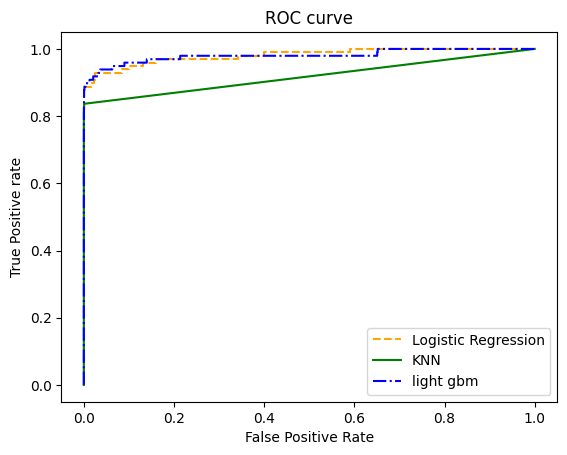

In [23]:
# plot roc curves
plt.plot(fpr1, tpr1, linestyle='--',color='orange', label='Logistic Regression')
plt.plot(fpr2, tpr2, linestyle='-',color='green', label='KNN')
plt.plot(fpr3, tpr3, linestyle='-.',color='blue', label='light gbm')

# title
plt.title('ROC curve')
# x label
plt.xlabel('False Positive Rate')
# y label
plt.ylabel('True Positive rate')

plt.legend(loc='best')
plt.savefig('ROC',dpi=300)
plt.show();

RESULT UNDERSTANDING
1. Among all the three lightgbm is highly accurate overall but has room for improvement in recall for the "Fraud" class.

## Approach-2 : Normalizing all features

### 1.Feature Engineering

##### Normalization of all features

In [24]:
df = pd.read_csv('../data/creditcard.csv')
y=df['Class']

scaler=StandardScaler()
x=scaler.fit_transform(df.drop(columns='Class', axis=1))

##### Train Test Split

In [25]:
x_train, x_test, y_train, y_test=train_test_split(x,y, test_size=0.20, random_state=123)
print(f'x_train{x_train.shape}\n, x_test{x_test.shape}\n, y_train{y_train.shape}\n, y_test{y_test.shape}')

x_train(227845, 30)
, x_test(56962, 30)
, y_train(227845,)
, y_test(56962,)


### 2.Model Building

#### Model-1 : Light gbm

In [26]:
y_pred, y_score, lgbm_clf= lgbm_model(x_train, y_train, x_test, y_test)

____________________________________________________________________________________________________
TRAIN MODEL CLASSIFICATION REPORT
____________________________________________________________________________________________________
              precision    recall  f1-score   support

    No Fraud       1.00      0.99      1.00    227468
       Fraud       0.11      0.70      0.20       377

    accuracy                           0.99    227845
   macro avg       0.56      0.84      0.60    227845
weighted avg       1.00      0.99      0.99    227845

____________________________________________________________________________________________________
TEST MODEL CLASSIFICATION REPORT
____________________________________________________________________________________________________
              precision    recall  f1-score   support

    No Fraud       1.00      0.99      0.99     56847
       Fraud       0.13      0.68      0.21       115

    accuracy                          

#### Model Performance

In [27]:
data = {'x_train':x_train,'x_test':x_test,'y_train':y_train,'y_test':y_test,'y_pred':y_pred,'y_score':y_score}
model_performance_lgbm('lgbm_clf', **data)

#### Hyperparameter Tuning

In [69]:
fit_params = {#"early_stopping_rounds" : 50, 
             "eval_metric" : 'binary', 
             "eval_set" : [(x_test,y_test)],
             'eval_names': ['valid'],
             #'verbose': 0,
             'categorical_feature': 'auto'}

param_test = {'learning_rate' : [0.01, 0.02, 0.03, 0.04, 0.05, 0.08, 0.1, 0.2, 0.3, 0.4],
              'n_estimators' : [100, 200, 300, 400, 500, 600, 800, 1000, 1500, 2000, 3000, 5000],
              'num_leaves': sp_randint(6, 50), 
              'min_child_samples': sp_randint(100, 500), 
              'min_child_weight': [1e-5, 1e-3, 1e-2, 1e-1, 1, 1e1, 1e2, 1e3, 1e4],
              'subsample': sp_uniform(loc=0.2, scale=0.8), 
              'max_depth': [-1, 1, 2, 3, 4, 5, 6, 7],
              'colsample_bytree': sp_uniform(loc=0.4, scale=0.6),
              'reg_alpha': [0, 1e-1, 1, 2, 5, 7, 10, 50, 100],
              'reg_lambda': [0, 1e-1, 1, 5, 10, 20, 50, 100]}

#number of combinations
n_iter = 200

#intialize lgbm and lunch the search
lgbm_clf = lgbm.LGBMClassifier(random_state=random_state, silent=True, metric='None', n_jobs=4, verbose=-100)
grid_search = RandomizedSearchCV(
    estimator=lgbm_clf, param_distributions=param_test, 
    n_iter=n_iter,
    scoring='accuracy',
    cv=5,
    refit=True,
    random_state=random_state,
    verbose=True)

grid_search.fit(x_train, y_train, **fit_params)
print('Best score reached: {} with params: {} '.format(grid_search.best_score_, grid_search.best_params_))

opt_parameters =  grid_search.best_params_

clf_sw = lgbm.LGBMClassifier(**lgbm_clf.get_params())
#Optimal parameter
clf_sw.set_params(**opt_parameters)

Fitting 5 folds for each of 200 candidates, totalling 1000 fits
Best score reached: 0.9995962167262832 with params: {'colsample_bytree': 0.8924840627343202, 'learning_rate': 0.2, 'max_depth': 6, 'min_child_samples': 307, 'min_child_weight': 0.01, 'n_estimators': 500, 'num_leaves': 49, 'reg_alpha': 0.1, 'reg_lambda': 20, 'subsample': 0.9699607348770118} 


LGBMClassifier(colsample_bytree=0.8924840627343202, learning_rate=0.2,
               max_depth=6, metric='None', min_child_samples=307,
               min_child_weight=0.01, n_estimators=500, n_jobs=4, num_leaves=49,
               random_state=7, reg_alpha=0.1, reg_lambda=20, silent=True,
               subsample=0.9699607348770118, verbose=-100)

#### LightGBM Model Training After Hyperparameter Tuning(RandomizedSearchCV)

In [28]:
def lgbm_model_tuned(x_train, y_train, x_test, y_test):
  clf = lgbm.LGBMClassifier(colsample_bytree=0.8924840627343202, importance_type='split',
        learning_rate=0.2, max_depth=6, metric='None',
        min_child_samples=307, min_child_weight=0.01,
        n_estimators=500, n_jobs=4, num_leaves=49,
        random_state=7, reg_alpha=0.1, reg_lambda=20, silent=True,
        subsample=0.9699607348770118,verbose=-100)
  clf.fit(x_train, y_train)
  y_train_pred=clf.predict(x_train)
  y_train_cl_report=classification_report(y_train, y_train_pred, target_names = ['No Fraud', 'Fraud'])
  print("_"*100)
  print("TRAIN MODEL CLASSIFICATION REPORT")
  print("_"*100)
  print(y_train_cl_report)
  y_pred=clf.predict(x_test)
  y_score = clf.predict_proba(x_test)[:,1]
  y_test_cl_report=classification_report(y_test, y_pred, target_names = ['No Fraud', 'Fraud'])
  print("_"*100)
  print("TEST MODEL CLASSIFICATION REPORT")
  print("_"*100)
  print(y_test_cl_report)
  print("_"*100)
  return y_pred, y_score, clf


In [29]:
y_pred, y_score, lgbm_clf_tuned= lgbm_model_tuned(x_train, y_train, x_test, y_test)

____________________________________________________________________________________________________
TRAIN MODEL CLASSIFICATION REPORT
____________________________________________________________________________________________________
              precision    recall  f1-score   support

    No Fraud       1.00      1.00      1.00    227468
       Fraud       1.00      1.00      1.00       377

    accuracy                           1.00    227845
   macro avg       1.00      1.00      1.00    227845
weighted avg       1.00      1.00      1.00    227845

____________________________________________________________________________________________________
TEST MODEL CLASSIFICATION REPORT
____________________________________________________________________________________________________
              precision    recall  f1-score   support

    No Fraud       1.00      1.00      1.00     56847
       Fraud       0.93      0.83      0.88       115

    accuracy                          

#### Model Performance

In [30]:
data = {'x_train':x_train,'x_test':x_test,'y_train':y_train,'y_test':y_test,'y_pred':y_pred,'y_score':y_score}
model_performance_lgbm('lgbm_clf_tuned',**data)

### Model-2 : Logistic Regression

In [31]:
y_pred, y_score, lr= logic_regression(x_train, y_train, x_test, y_test)

____________________________________________________________________________________________________
TRAIN MODEL CLASSIFICATION REPORT
____________________________________________________________________________________________________
              precision    recall  f1-score   support

    No Fraud       1.00      1.00      1.00    227468
       Fraud       0.89      0.63      0.74       377

    accuracy                           1.00    227845
   macro avg       0.94      0.81      0.87    227845
weighted avg       1.00      1.00      1.00    227845

____________________________________________________________________________________________________
TEST MODEL CLASSIFICATION REPORT
____________________________________________________________________________________________________
              precision    recall  f1-score   support

    No Fraud       1.00      1.00      1.00     56847
       Fraud       0.83      0.61      0.70       115

    accuracy                          

#### Model Performance

In [32]:
data = {'x_train':x_train,'x_test':x_test,'y_train':y_train,'y_test':y_test,'y_pred':y_pred,'y_score':y_score}
model_performance('lr',**data)

### Model-3 : KNEIGHBORS CLASSIFICATION MODEL

In [33]:
y_pred, y_score, knn= KNeighbors(x_train, y_train, x_test, y_test)

____________________________________________________________________________________________________
TRAIN MODEL CLASSIFICATION REPORT
____________________________________________________________________________________________________
              precision    recall  f1-score   support

    No Fraud       1.00      1.00      1.00    227468
       Fraud       0.97      0.79      0.87       377

    accuracy                           1.00    227845
   macro avg       0.99      0.89      0.93    227845
weighted avg       1.00      1.00      1.00    227845

____________________________________________________________________________________________________
TEST MODEL CLASSIFICATION REPORT
____________________________________________________________________________________________________
              precision    recall  f1-score   support

    No Fraud       1.00      1.00      1.00     56847
       Fraud       0.95      0.78      0.86       115

    accuracy                          

#### Model Performance

In [34]:
data = {'x_train':x_train,'x_test':x_test,'y_train':y_train,'y_test':y_test,'y_pred':y_pred,'y_score':y_score}
model_performance('knn',**data)

### 3.ROC Curve and Optimal Thresholds for lightgbm, Logistic Regression and K-Neighbors Models

In [35]:
lr_prob=lr.predict_proba(x_test)
KNeib_prob=knn.predict_proba(x_test)
lgbm_prob = lgbm_clf_tuned.predict_proba(x_test)
fpr1, tpr1, thresh1=roc_curve(y_test, lr_prob[:,1], pos_label=1)
fpr2, tpr2, thresh2=roc_curve(y_test, KNeib_prob[:,1], pos_label=1)
fpr3, tpr3, thresh3=roc_curve(y_test, lgbm_prob[:,1], pos_label=1)

optimal_thres_lr=thresh1[np.argmax(tpr1 - fpr1)]
optimal_thres_knn=thresh2[np.argmax(tpr2 - fpr2)]
optimal_thres_lgbm=thresh3[np.argmax(tpr3 - fpr3)]

print(f" optimal_thres_lr\t {optimal_thres_lr} \n optimal_thres_KNeib\t{optimal_thres_knn} \n optimal_thres_lgbm\t{optimal_thres_lgbm}")

 optimal_thres_lr	 0.007890862083875499 
 optimal_thres_KNeib	0.25 
 optimal_thres_lgbm	0.0001845384005702141


In [36]:
opt={'Logistic Regression':optimal_thres_lr,'KNeighbors Classification':optimal_thres_knn, 'light gbm':optimal_thres_lgbm}
for model, thresh in opt.items():
  if model == 'Logistic Regression':
    y_test_pred_adj=lr.predict_proba(x_test)[:,1]
  elif model =='KNeighbors Classification':
    y_test_pred_adj=knn.predict_proba(x_test)[:,1]
  elif model == 'light gbm':
    y_test_pred_adj=lgbm_clf_tuned.predict_proba(x_test)[:,1]
    
  y_test_pred_adj1 = (y_test_pred_adj >= thresh).astype(int)
  ac_score = accuracy_score(y_test, y_test_pred_adj1)
  ROC_AC=roc_auc_score(y_test, y_test_pred_adj1)
  
  print("_" * 50)
  print(f"Model: {model}")
  print(f"Threshold: {thresh}")
  print(f"Accuracy Score: {ac_score}")
  print(f"ROC Accuracy Score: {ROC_AC}")
  print("_" * 50)
    
  y_test_cl_report_adj = classification_report(y_test, y_test_pred_adj1, target_names=['No Fraud', 'Fraud'])
  print("_" * 50)
  print("Classification Report:")
  print(y_test_cl_report_adj)
  print("_" * 50)

__________________________________________________
Model: Logistic Regression
Threshold: 0.007890862083875499
Accuracy Score: 0.9960675538078017
ROC Accuracy Score: 0.945961432709156
__________________________________________________
__________________________________________________
Classification Report:
              precision    recall  f1-score   support

    No Fraud       1.00      1.00      1.00     56847
       Fraud       0.33      0.90      0.48       115

    accuracy                           1.00     56962
   macro avg       0.66      0.95      0.74     56962
weighted avg       1.00      1.00      1.00     56962

__________________________________________________
__________________________________________________
Model: KNeighbors Classification
Threshold: 0.25
Accuracy Score: 0.9985955549313578
ROC Accuracy Score: 0.9298718681189247
__________________________________________________
__________________________________________________
Classification Report:
              p

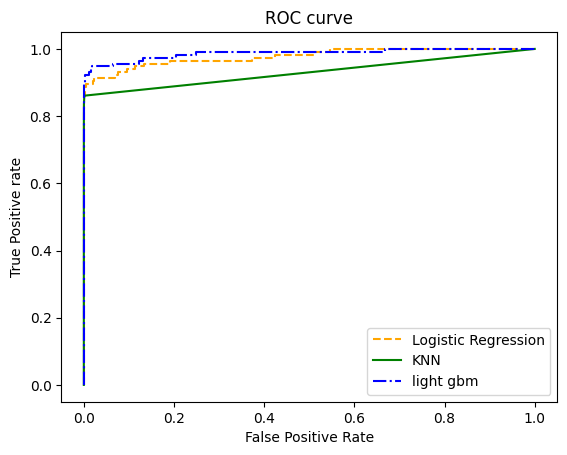

In [37]:
# plot roc curves
plt.plot(fpr1, tpr1, linestyle='--',color='orange', label='Logistic Regression')
plt.plot(fpr2, tpr2, linestyle='-',color='green', label='KNN')
plt.plot(fpr3, tpr3, linestyle='-.',color='blue', label='light gbm')

# title
plt.title('ROC curve')
# x label
plt.xlabel('False Positive Rate')
# y label
plt.ylabel('True Positive rate')

plt.legend(loc='best')
plt.savefig('ROC',dpi=300)
plt.show()

## Approach-3 : Resampling

### 1.Feature Engineering

##### Resampling Techniques

In [43]:
df = pd.read_csv('../data/creditcard.csv')

In [44]:
df['Class'].value_counts()

Class
0    284315
1       492
Name: count, dtype: int64

1. Data is not balanced if you see 0 legit transactions are 284315, where as fraud transations are 492
2. so we are using the Resampling Technique

Under-sampling the Majority Class:
1. Randomly remove instances from the majority class to balance the class distribution.
2. Be cautious not to remove too much data, as it may result in information loss.
3. Created the 2 dataset based on classifications with equal rows

In [45]:
df_0 = df[df['Class'] == 0].sample(n=492, random_state=42)
df_1= df[df['Class'] == 1].sample(n=492, random_state=42)
print(f' Fraud Shape{df_1.shape}\n No Fraud shape{df_0.shape}')

 Fraud Shape(492, 31)
 No Fraud shape(492, 31)


In [46]:
df_concat=pd.concat([df_0,df_1], ignore_index=True)
df_concat.shape

(984, 31)

##### Balance Dataset Train Test Split

In [47]:
x_bal=df_concat.drop('Class', axis=1)
y_bal=df_concat['Class']
print(x_bal.shape, '\n', y_bal.shape)


(984, 30) 
 (984,)


In [48]:
x_bal=scaler.fit_transform(x_bal)

In [49]:
x_train_b, x_test_b, y_train_b, y_test_b=train_test_split(x_bal,y_bal, test_size=0.20, random_state=123)
print(f'x_train{x_train_b.shape}\n, x_test{x_test_b.shape}\n, y_train{y_train_b.shape}\n, y_test{y_test_b.shape}')

x_train(787, 30)
, x_test(197, 30)
, y_train(787,)
, y_test(197,)


### 2.Model Building

#### Model-1 : Light gbm

In [50]:
y_pred_b, y_score_b, lgbm_clf_b= lgbm_model(x_train_b, y_train_b, x_test_b, y_test_b)

____________________________________________________________________________________________________
TRAIN MODEL CLASSIFICATION REPORT
____________________________________________________________________________________________________
              precision    recall  f1-score   support

    No Fraud       1.00      1.00      1.00       383
       Fraud       1.00      1.00      1.00       404

    accuracy                           1.00       787
   macro avg       1.00      1.00      1.00       787
weighted avg       1.00      1.00      1.00       787

____________________________________________________________________________________________________
TEST MODEL CLASSIFICATION REPORT
____________________________________________________________________________________________________
              precision    recall  f1-score   support

    No Fraud       0.94      0.94      0.94       109
       Fraud       0.92      0.92      0.92        88

    accuracy                          

#### Model Performance

In [51]:
data = {'x_train':x_train_b,'x_test':x_test_b,'y_train':y_train_b,'y_test':y_test_b,'y_pred':y_pred_b,'y_score':y_score_b}
model_performance_lgbm('lgbm_clf_b', **data)

#### Hyperparameter Tuning

In [53]:
fit_params = {#"early_stopping_rounds" : 50, 
             "eval_metric" : 'binary', 
             "eval_set" : [(x_test_b,y_test_b)],
             'eval_names': ['valid'],
             #'verbose': 0,
             'categorical_feature': 'auto'}

param_test = {'learning_rate' : [0.01, 0.02, 0.03, 0.04, 0.05, 0.08, 0.1, 0.2, 0.3, 0.4],
              'n_estimators' : [100, 200, 300, 400, 500, 600, 800, 1000, 1500, 2000, 3000, 5000],
              'num_leaves': sp_randint(6, 50), 
              'min_child_samples': sp_randint(100, 500), 
              'min_child_weight': [1e-5, 1e-3, 1e-2, 1e-1, 1, 1e1, 1e2, 1e3, 1e4],
              'subsample': sp_uniform(loc=0.2, scale=0.8), 
              'max_depth': [-1, 1, 2, 3, 4, 5, 6, 7],
              'colsample_bytree': sp_uniform(loc=0.4, scale=0.6),
              'reg_alpha': [0, 1e-1, 1, 2, 5, 7, 10, 50, 100],
              'reg_lambda': [0, 1e-1, 1, 5, 10, 20, 50, 100]}

#number of combinations
n_iter = 200

#intialize lgbm and launch the search
lgbm_clf = lgbm.LGBMClassifier(random_state=random_state, silent=True, metric='None', n_jobs=4, verbose=-100)
grid_search = RandomizedSearchCV(
    estimator=lgbm_clf, param_distributions=param_test, 
    n_iter=n_iter,
    scoring='accuracy',
    cv=5,
    refit=True,
    random_state=random_state,
    verbose=True)

grid_search.fit(x_train_b, y_train_b, **fit_params)
print('Best score reached: {} with params: {} '.format(grid_search.best_score_, grid_search.best_params_))

opt_parameters =  grid_search.best_params_

clf_sw = lgbm.LGBMClassifier(**lgbm_clf.get_params())
#Optimal parameter
clf_sw.set_params(**opt_parameters)

Fitting 5 folds for each of 200 candidates, totalling 1000 fits
Best score reached: 0.9415383374989922 with params: {'colsample_bytree': 0.6823517928219648, 'learning_rate': 0.03, 'max_depth': -1, 'min_child_samples': 131, 'min_child_weight': 0.001, 'n_estimators': 2000, 'num_leaves': 20, 'reg_alpha': 5, 'reg_lambda': 0.1, 'subsample': 0.7234294618506933} 


LGBMClassifier(colsample_bytree=0.6823517928219648, learning_rate=0.03,
               metric='None', min_child_samples=131, n_estimators=2000,
               n_jobs=4, num_leaves=20, random_state=7, reg_alpha=5,
               reg_lambda=0.1, silent=True, subsample=0.7234294618506933,
               verbose=-100)

#### LightGBM Model Training After Hyperparameter Tuning(RandomizedSearchCV)

In [59]:
def lgbm_model_tuned(x_train, y_train, x_test, y_test):
  clf = lgbm.LGBMClassifier(colsample_bytree=0.6823517928219648, importance_type='split',
        learning_rate=0.03, metric='None',
        min_child_samples=131,
        n_estimators=2000, n_jobs=4, num_leaves=20,
        random_state=7, reg_alpha=5, reg_lambda=0.1, silent=True,
        subsample=0.7234294618506933,verbose=-100)
  clf.fit(x_train, y_train)
  y_train_pred=clf.predict(x_train)
  y_train_cl_report=classification_report(y_train, y_train_pred, target_names = ['No Fraud', 'Fraud'])
  print("_"*100)
  print("TRAIN MODEL CLASSIFICATION REPORT")
  print("_"*100)
  print(y_train_cl_report)
  y_pred=clf.predict(x_test)
  y_score = clf.predict_proba(x_test)[:,1]
  y_test_cl_report=classification_report(y_test, y_pred, target_names = ['No Fraud', 'Fraud'])
  print("_"*100)
  print("TEST MODEL CLASSIFICATION REPORT")
  print("_"*100)
  print(y_test_cl_report)
  print("_"*100)
  return y_pred, y_score, clf


In [60]:
y_pred_b, y_score_b, lgbm_clf_tuned_b= lgbm_model_tuned(x_train_b, y_train_b, x_test_b, y_test_b)

____________________________________________________________________________________________________
TRAIN MODEL CLASSIFICATION REPORT
____________________________________________________________________________________________________
              precision    recall  f1-score   support

    No Fraud       0.93      0.98      0.96       383
       Fraud       0.98      0.93      0.96       404

    accuracy                           0.96       787
   macro avg       0.96      0.96      0.96       787
weighted avg       0.96      0.96      0.96       787

____________________________________________________________________________________________________
TEST MODEL CLASSIFICATION REPORT
____________________________________________________________________________________________________
              precision    recall  f1-score   support

    No Fraud       0.93      0.94      0.94       109
       Fraud       0.93      0.91      0.92        88

    accuracy                          

#### Model Performance

In [61]:
data = {'x_train':x_train_b,'x_test':x_test_b,'y_train':y_train_b,'y_test':y_test_b,'y_pred':y_pred_b,'y_score':y_score_b}
model_performance_lgbm('lgbm_clf_tuned_b',**data)

### Model-2 : Logistic Regression

In [58]:
y_pred_b, y_score_b, lr_b= logic_regression(x_train_b, y_train_b, x_test_b,y_test_b)

____________________________________________________________________________________________________
TRAIN MODEL CLASSIFICATION REPORT
____________________________________________________________________________________________________
              precision    recall  f1-score   support

    No Fraud       0.92      0.98      0.95       383
       Fraud       0.98      0.92      0.95       404

    accuracy                           0.95       787
   macro avg       0.95      0.95      0.95       787
weighted avg       0.95      0.95      0.95       787

____________________________________________________________________________________________________
TEST MODEL CLASSIFICATION REPORT
____________________________________________________________________________________________________
              precision    recall  f1-score   support

    No Fraud       0.94      0.97      0.95       109
       Fraud       0.96      0.92      0.94        88

    accuracy                          

#### Model Performance

In [ ]:
data = {'x_train':x_train_b,'x_test':x_test_b,'y_train':y_train_b,'y_test':y_test_b,'y_pred':y_pred_b,'y_score':y_score_b}
model_performance('lr_b',**data)

### Model-3 : KNEIGHBORS CLASSIFICATION MODEL

In [63]:
y_pred_b, y_score_b, knn_b= KNeighbors(x_train_b, y_train_b, x_test_b, y_test_b)

____________________________________________________________________________________________________
TRAIN MODEL CLASSIFICATION REPORT
____________________________________________________________________________________________________
              precision    recall  f1-score   support

    No Fraud       0.88      0.99      0.93       383
       Fraud       0.99      0.87      0.93       404

    accuracy                           0.93       787
   macro avg       0.94      0.93      0.93       787
weighted avg       0.94      0.93      0.93       787

____________________________________________________________________________________________________
TEST MODEL CLASSIFICATION REPORT
____________________________________________________________________________________________________
              precision    recall  f1-score   support

    No Fraud       0.89      1.00      0.94       109
       Fraud       1.00      0.84      0.91        88

    accuracy                          

#### Model Performance

In [64]:
data = {'x_train':x_train_b,'x_test':x_test_b,'y_train':y_train_b,'y_test':y_test_b,'y_pred':y_pred_b,'y_score':y_score_b}
model_performance('knn_b',**data)

### 3.ROC Curve and Optimal Thresholds for lightgbm, Logistic Regression and K-Neighbors Models

In [65]:
lr_prob=lr_b.predict_proba(x_test_b)
KNeib_prob=knn_b.predict_proba(x_test_b)
lgbm_prob = lgbm_clf_tuned_b.predict_proba(x_test_b)
fpr1, tpr1, thresh1=roc_curve(y_test_b, lr_prob[:,1], pos_label=1)
fpr2, tpr2, thresh2=roc_curve(y_test_b, KNeib_prob[:,1], pos_label=1)
fpr3, tpr3, thresh3=roc_curve(y_test_b, lgbm_prob[:,1], pos_label=1)

optimal_thres_lr=thresh1[np.argmax(tpr1 - fpr1)]
optimal_thres_knn=thresh2[np.argmax(tpr2 - fpr2)]
optimal_thres_lgbm=thresh3[np.argmax(tpr3 - fpr3)]

print(f" optimal_thres_lr\t {optimal_thres_lr} \n optimal_thres_KNeib\t{optimal_thres_knn} \n optimal_thres_lgbm\t{optimal_thres_lgbm}")

 optimal_thres_lr	 0.5683786848192031 
 optimal_thres_KNeib	0.75 
 optimal_thres_lgbm	0.8472935187868058


In [66]:
opt={'Logistic Regression':optimal_thres_lr,'KNeighbors Classification':optimal_thres_knn, 'light gbm':optimal_thres_lgbm}
for model, thresh in opt.items():
  if model == 'Logistic Regression':
    y_test_pred_adj=lr_b.predict_proba(x_test_b)[:,1]
  elif model =='KNeighbors Classification':
    y_test_pred_adj=knn_b.predict_proba(x_test_b)[:,1]
  elif model == 'light gbm':
    y_test_pred_adj=lgbm_clf_tuned_b.predict_proba(x_test_b)[:,1]
    
  y_test_pred_adj1 = (y_test_pred_adj >= thresh).astype(int)
  ac_score = accuracy_score(y_test_b, y_test_pred_adj1)
  ROC_AC=roc_auc_score(y_test_b, y_test_pred_adj1)
  
  print("_" * 50)
  print(f"Model: {model}")
  print(f"Threshold: {thresh}")
  print(f"Accuracy Score: {ac_score}")
  print(f"ROC Accuracy Score: {ROC_AC}")
  print("_" * 50)
    
  y_test_cl_report_adj = classification_report(y_test_b, y_test_pred_adj1, target_names=['No Fraud', 'Fraud'])
  print("_" * 50)
  print("Classification Report:")
  print(y_test_cl_report_adj)
  print("_" * 50)

__________________________________________________
Model: Logistic Regression
Threshold: 0.5683786848192031
Accuracy Score: 0.949238578680203
ROC Accuracy Score: 0.9464658048373643
__________________________________________________
__________________________________________________
Classification Report:
              precision    recall  f1-score   support

    No Fraud       0.94      0.97      0.95       109
       Fraud       0.96      0.92      0.94        88

    accuracy                           0.95       197
   macro avg       0.95      0.95      0.95       197
weighted avg       0.95      0.95      0.95       197

__________________________________________________


__________________________________________________
Model: KNeighbors Classification
Threshold: 0.75
Accuracy Score: 0.9289340101522843
ROC Accuracy Score: 0.9204545454545454
__________________________________________________
__________________________________________________
Classification Report:
              precision    recall  f1-score   support

    No Fraud       0.89      1.00      0.94       109
       Fraud       1.00      0.84      0.91        88

    accuracy                           0.93       197
   macro avg       0.94      0.92      0.93       197
weighted avg       0.94      0.93      0.93       197

__________________________________________________
__________________________________________________
Model: light gbm
Threshold: 0.8472935187868058
Accuracy Score: 0.9441624365482234
ROC Accuracy Score: 0.9385946622185154
__________________________________________________
__________________________________________________
Classification Report:
              precision   

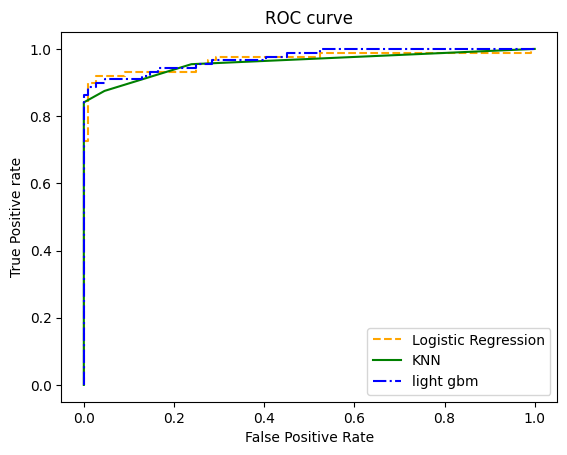

In [67]:
# plot roc curves
plt.plot(fpr1, tpr1, linestyle='--',color='orange', label='Logistic Regression')
plt.plot(fpr2, tpr2, linestyle='-',color='green', label='KNN')
plt.plot(fpr3, tpr3, linestyle='-.',color='blue', label='light gbm')

# title
plt.title('ROC curve')
# x label
plt.xlabel('False Positive Rate')
# y label
plt.ylabel('True Positive rate')

plt.legend(loc='best')
plt.savefig('ROC',dpi=300)
plt.show()

In [4]:
import cloudpickle

df = pd.read_csv('../data/creditcard.csv')

df_0 = df[df['Class'] == 0].sample(n=492, random_state=42)
df_1= df[df['Class'] == 1].sample(n=492, random_state=42)
df_concat=pd.concat([df_0,df_1], ignore_index=True)

x_bal = df_concat.drop(columns='Class', axis=1)
y_bal = df_concat['Class']

x_train_b, x_test_b, y_train_b, y_test_b=train_test_split(x_bal,y_bal, test_size=0.20, random_state=123)

numeric_cols = [f'V{i}' for i in range(1,29)] + ['Time', 'Amount']
numeric_transformer = StandardScaler()

preprocessor = ColumnTransformer(transformers=[('num',numeric_transformer,numeric_cols)])

clf = Pipeline(steps=[('preprocessor',preprocessor), 
                      ('classifier',lgbm.LGBMClassifier(colsample_bytree=0.8924840627343202,
                                                        learning_rate=0.2, max_depth=6, metric='None',
                                                        min_child_samples=307, min_child_weight=0.01,
                                                        n_estimators=500, n_jobs=4, num_leaves=49,
                                                        random_state=7, reg_alpha=0.1, reg_lambda=20, silent=True,
                                                        subsample=0.9699607348770118, subsample_for_bin=200000,
                                                        subsample_freq=0, verbose=-100))
                        ])

clf.fit(x_train_b,y_train_b)
print(classification_report(y_train_b, clf.predict(x_train_b), target_names = ['No Fraud', 'Fraud']))
print(classification_report(y_test_b, clf.predict(x_test_b), target_names = ['No Fraud', 'Fraud']))

with open('model.pkl', 'wb') as out:
    cloudpickle.dump(clf,out)

              precision    recall  f1-score   support

    No Fraud       0.94      0.99      0.96       383
       Fraud       0.99      0.94      0.96       404

    accuracy                           0.96       787
   macro avg       0.96      0.96      0.96       787
weighted avg       0.96      0.96      0.96       787

              precision    recall  f1-score   support

    No Fraud       0.94      0.93      0.93       109
       Fraud       0.91      0.92      0.92        88

    accuracy                           0.92       197
   macro avg       0.92      0.92      0.92       197
weighted avg       0.92      0.92      0.92       197



Conclusion:
1. Depending on the specific requirements of problem (e.g., the importance of false positives vs. false negatives), we may choose one model over the other based on the balance between precision and recall.

2. Considering the context of Credit Card Fault Prediction application  misclassifications are more costly than others.

3. Hence I am selecting the Approach-3: Resampling and Normalizing all features and lightGBM moedl as this model is giving highest Recall of 0.9091 of among all others and good ROC area of 0.972.
